In [14]:
import os
if not os.path.exists('thinkdsp.py'):
    !wget https://github.com/AllenDowney/ThinkDSP/raw/master/code/thinkdsp.py

In [15]:
from thinkdsp import read_wave, CosSignal, SinSignal
import matplotlib.pyplot as plt

def load_and_normalize(filename):
    audio = read_wave(filename)
    audio.normalize()
    return audio

def plot_waveform(waveform, x_label):
    plt.figure(figsize=(8, 4))
    waveform.plot()
    plt.xlabel(x_label)
    plt.ylabel('Амплитуда')
    plt.grid(True)
    plt.show()

def plot_spectrum(spectrum, max_freq=None, x_label='Частота (Гц)'):
    plt.figure(figsize=(8, 4))
    spectrum.plot(high=max_freq)
    plt.xlabel(x_label)
    plt.ylabel('Амплитуда')
    plt.grid(True)
    plt.show()

def extract_segment(waveform, start_time, duration):
    return waveform.segment(start=start_time, duration=duration)

def apply_low_pass(spectrum, cutoff):
    spectrum.low_pass(cutoff)
    return spectrum

def stretch_waveform(waveform, factor):
    waveform.ts *= factor
    waveform.framerate /= factor
    return waveform

audio_file = '1.1.wav'
sound = load_and_normalize(audio_file)
sound.make_audio()

Упражнение 1.2

После загрузки аудиозаписи с Freesound.org была выполнена её нормализация, на основе чего был построен график формы волны. Из исходного сигнала выделили короткий сегмент, в котором частота звука оставалась неизменной. Для этого сегмента был рассчитан спектр, наглядно демонстрирующий основные гармоники, отвечающие за тембр. С целью более детального изучения гармоник, спектр был ограничен диапазоном до 4000 Гц. Затем был применён фильтр низких частот, устраняющий компоненты выше 500 Гц, что привело к заметному "оглушению" звука. Восстановленный после фильтрации сигнал был снова проанализирован во временной области. Данный эксперимент показал, что низкие частоты придают звуку мягкость, тогда как удаление высоких частот приводит к потере тембральной окраски.

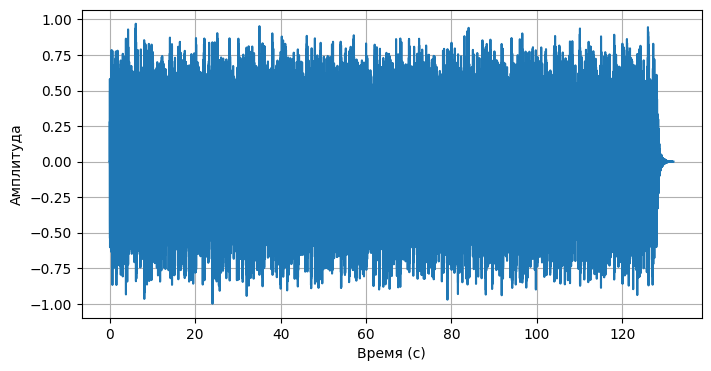

In [16]:
plot_waveform(sound, 'Время (с)')

part = extract_segment(sound, start_time=7.1, duration=0.5)
part.make_audio()

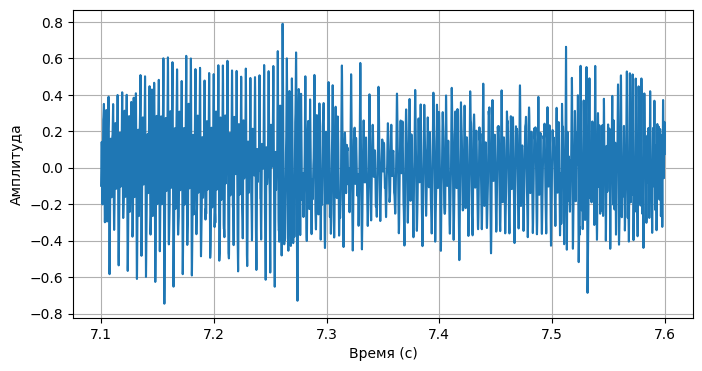

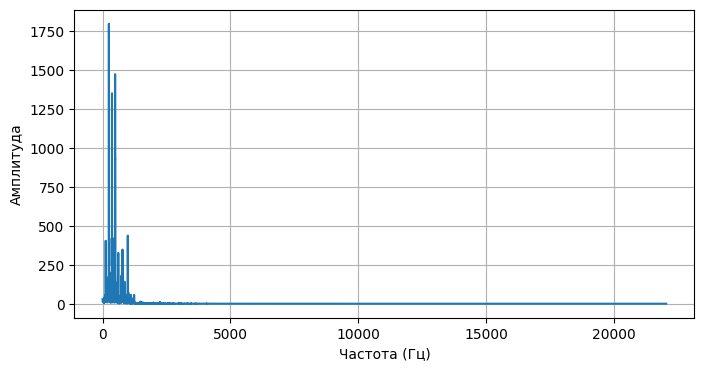

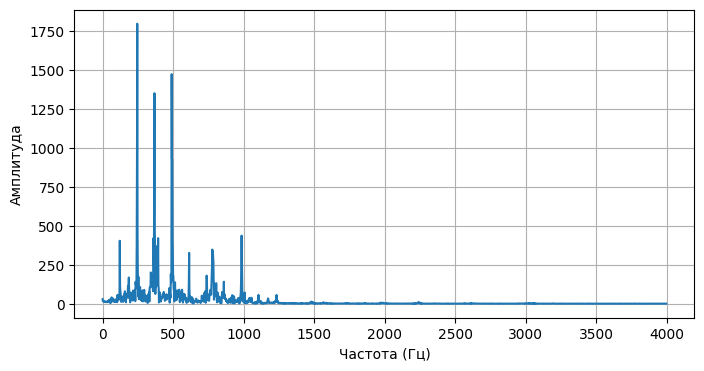

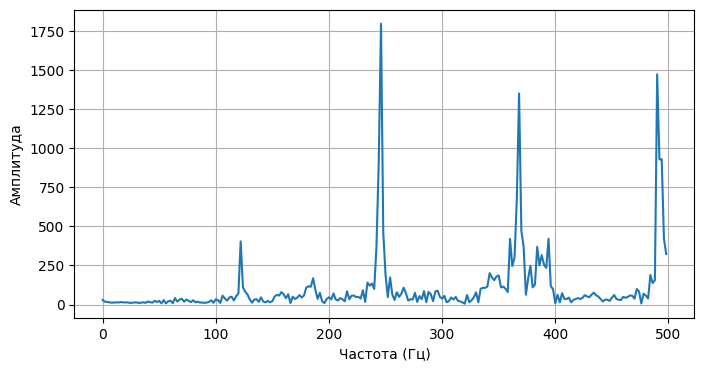

In [17]:
plot_waveform(part, 'Время (с)')

freq_spectrum = part.make_spectrum()
plot_spectrum(freq_spectrum, x_label='Частота (Гц)')
plot_spectrum(freq_spectrum, max_freq=4000, x_label='Частота (Гц)')

filtered_spectrum = apply_low_pass(freq_spectrum, cutoff=500)
plot_spectrum(filtered_spectrum, max_freq=500, x_label='Частота (Гц)')
filtered_wave = filtered_spectrum.make_wave()
filtered_wave.make_audio()

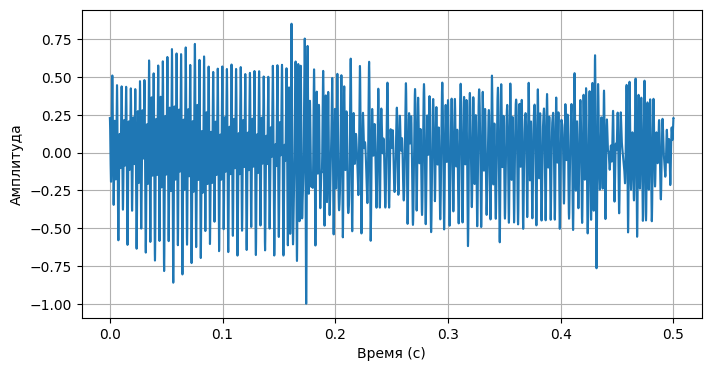

In [18]:
filtered_wave.normalize()
plot_waveform(filtered_wave, 'Время (с)')
filtered_spectrum.make_wave().make_audio()

Упражнение 1.3

Были сгенерированы два сигнала: синусоидальный с частотой 80 Гц и косинусоидальный с частотой 205 Гц. Их сумма создала звук, напоминающий старый телефонный звонок. Спектр результирующего сигнала чётко отобразил обе исходные частоты. Добавление частотных компонент, не являющихся кратными основным, привело к понижению и смягчению общего звучания. Для сглаживания краёв сигнала была применена аподизация, после чего был повторно построен спектр для наблюдения произошедших изменений.

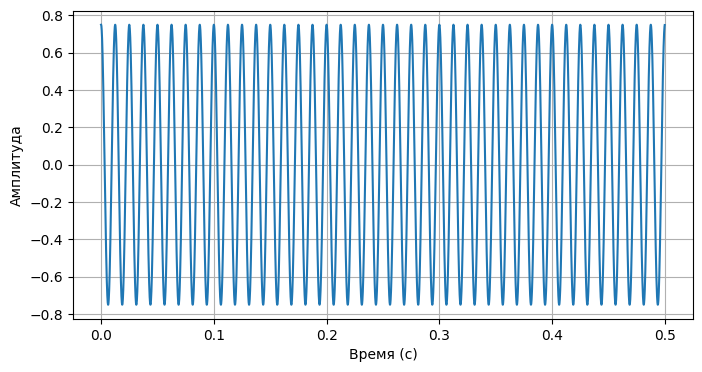

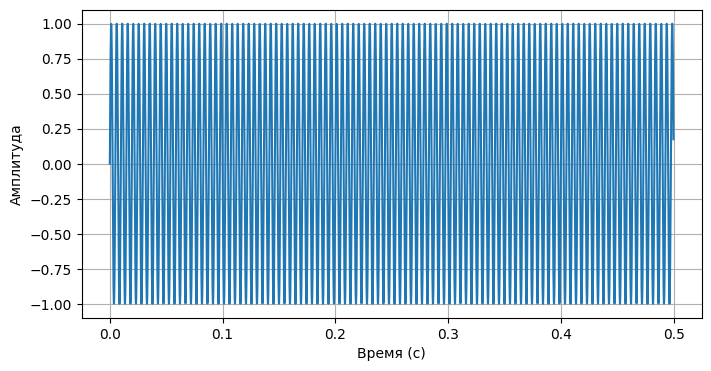

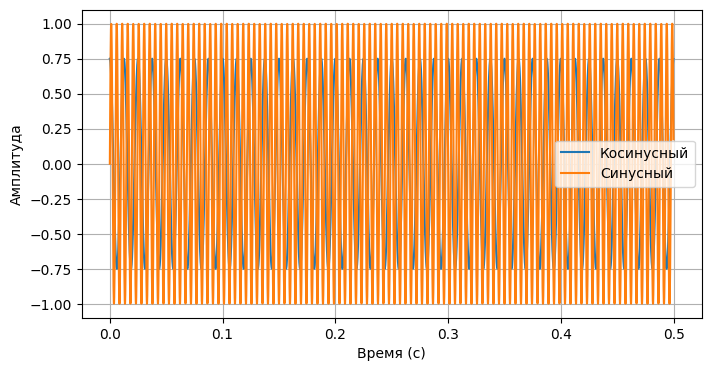

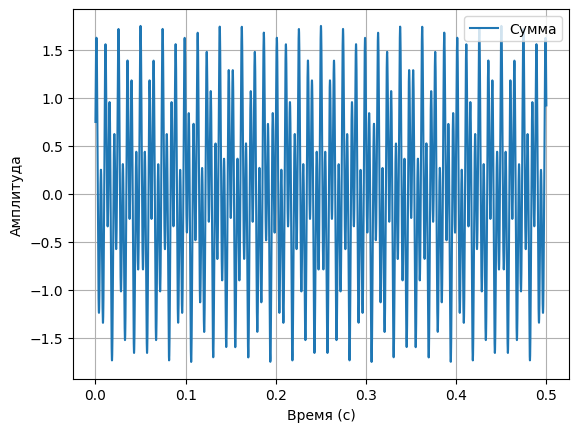

In [19]:
cosine = CosSignal(freq=80, amp=0.75)
sine = SinSignal(freq=205, amp=1.0)

plot_waveform(cosine.make_wave(duration=0.5), 'Время (с)')
plot_waveform(sine.make_wave(duration=0.5), 'Время (с)')

plt.figure(figsize=(8, 4))
cos_wave = cosine.make_wave(duration=0.5)
sin_wave = sine.make_wave(duration=0.5)
sum_wave = (cosine + sine).make_wave(duration=0.5)
plt.plot(cos_wave.ts, cos_wave.ys, label='Косинусный')
plt.plot(sin_wave.ts, sin_wave.ys, label='Синусный')
plt.xlabel('Время (с)')
plt.ylabel('Амплитуда')
plt.grid(True)
plt.legend()
plt.show()

plt.plot(sum_wave.ts, sum_wave.ys, label='Сумма')
plt.xlabel('Время (с)')
plt.ylabel('Амплитуда')
plt.grid(True)
plt.legend()
plt.show()

combined = cosine + sine
wave_one = combined.make_wave(duration=1.5, start=0, framerate=11025)
wave_one.make_audio()

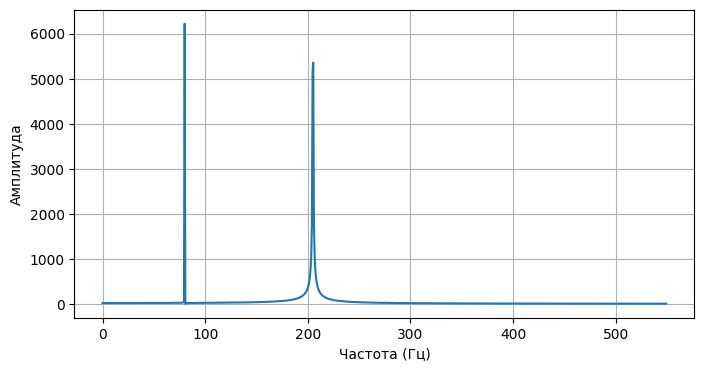

In [20]:
spectrum_one = wave_one.make_spectrum()
plot_spectrum(spectrum_one, max_freq=550, x_label='Частота (Гц)')

combined += SinSignal(freq=30)
wave_two = combined.make_wave()
wave_two.make_audio()

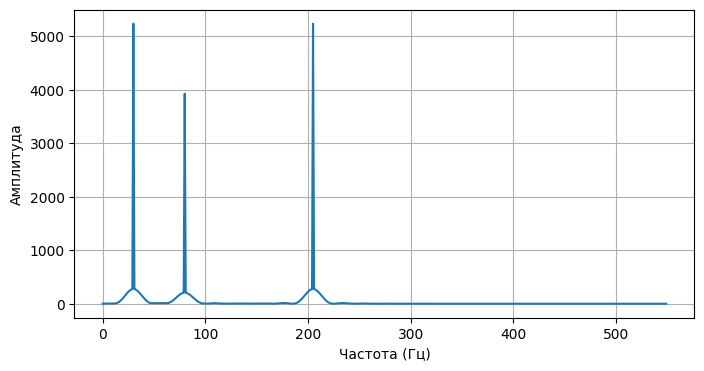

In [21]:
wave_two.apodize()
spectrum_two = wave_two.make_spectrum()
plot_spectrum(spectrum_two, max_freq=550, x_label='Частота (Гц)')

stretched = stretch_waveform(sound, 2.0)
stretched.make_audio()

Упражнение 1.4

Была разработана функция stretch для изменения длительности сигнала путём его растяжения или сжатия. В ходе эксперимента звук был замедлен в два раза. Это привело к снижению воспринимаемой частоты и увеличению общей продолжительности звучания.

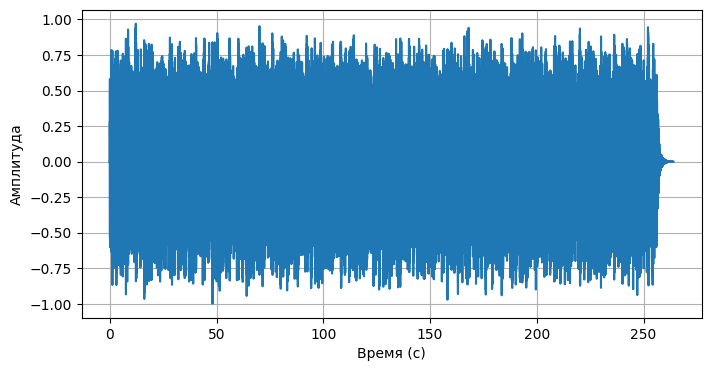

In [22]:
plot_waveform(stretched, 'Время (с)')

Вывод (Лабораторная работа №1):

В процессе выполнения лабораторной работы были освоены базовые операции по обработке звука с использованием библиотеки ThinkDSP в Python. Были изучены аудиофрагменты и их спектральные представления, применены методы фильтрации, проанализированы результаты сложения простых сигналов и выполнено изменение длительности звука. Полученные результаты способствовали лучшему пониманию влияния частотных характеристик на восприятие звука.